Centro de Estudos e Sistemas Avançados do Recife

Pós-graduação em Engenharia e Análise de Dados

Disciplina de RNA e Deep Learning

Professor: Silvan Ferreira da Silva Junior 
 
Grupo:
* Anísio Pereira Batista Filho (apbf@cesar.school)
* Carlos Cezar Lopes de Mendonça (cclm@cesar.school)
* Rodolpho Victor França Valsconcelos (rvfv@cesar.school)

In [1]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import datasets, transforms, models
from torchvision.models import MobileNet_V2_Weights, VGG16_Weights, ResNet18_Weights
from torch.utils.data import DataLoader, Subset
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


In [3]:
def train_model(model, trainloader, valloader, criterion, optimizer, device=device, num_epochs=5):
    history = {
        'train_losses': [],
        'val_losses': [],
        'train_accuracies': [],
        'val_accuracies': []
    }
    
    for epoch in range(num_epochs):
        # Treinamento
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        for i, data in tqdm(enumerate(trainloader, 0), total=len(trainloader)):
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()

            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

        train_loss = running_loss / len(trainloader)
        train_acc = 100 * correct / total
        history['train_losses'].append(train_loss)
        history['train_accuracies'].append(train_acc)
        print(f'Epoch {epoch+1}, Train Loss: {train_loss:.3f}, Train Accuracy: {train_acc:.2f}%')
        
        # Validação
        model.eval()
        val_running_loss = 0.0
        correct = 0
        total = 0
        with torch.no_grad():
            for data in valloader:
                inputs, labels = data
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_running_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                total += labels.size(0)
                correct += (predicted == labels).sum().item()

        val_loss = val_running_loss / len(valloader)
        val_acc = 100 * correct / total
        history['val_losses'].append(val_loss)
        history['val_accuracies'].append(val_acc)
        print(f'Epoch {epoch+1}, Val Loss: {val_loss:.3f}, Val Accuracy: {val_acc:.2f}%')

    print('Treinamento concluído')
    return history


def plot_history(history):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    ax1.plot(history['train_losses'], label='Train')
    ax1.plot(history['val_losses'], label='Validation')
    ax1.set_title('Loss')
    ax1.legend()

    ax2.plot(history['train_accuracies'], label='Train')
    ax2.plot(history['val_accuracies'], label='Validation')
    ax2.set_title('Accuracy')
    ax2.legend()

    plt.show()


def test_model(model, testloader, device=device):
    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

    print(f'Acurácia da rede na base de teste: {100 * correct / total:.2f}%')

In [4]:
# # Baixa e extrai o dataset
# !curl -L -o data/animais.zip "https://drive.google.com/uc?export=download&id=16Lll0Slg1unWxAb26AzZqI9sPdB_fYpV"
# !unzip data/animais.zip -d data

In [5]:
# Carregando os datasets
transform_aug = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

transform_no_aug = transforms.Compose([
    transforms.Resize(230),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# data_dir = 'data/hymenoptera_data'
data_dir = "data/animais"

train_set = datasets.ImageFolder(os.path.join(data_dir, 'train'), transform=transform_aug)
val_set = datasets.ImageFolder(os.path.join(data_dir, 'val'), transform=transform_no_aug)

train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32, shuffle=True)

In [6]:
model = models.resnet18(weights="IMAGENET1K_V1")

In [7]:
# Congelar todas as camadas
for param in model.parameters():
    param.requires_grad = False

In [8]:
# Substituir a última camada
model.fc = nn.Linear(model.fc.in_features, 2)
model = model.to(device)

In [9]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

In [10]:
# Treinando a CNN
history = train_model(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5)

  0%|          | 0/13 [00:00<?, ?it/s]

100%|██████████| 13/13 [01:48<00:00,  8.32s/it]


Epoch 1, Train Loss: 0.726, Train Accuracy: 52.00%


c:\Users\anisi\anaconda3\envs\cesarschool310\lib\site-packages\PIL\Image.py:1056: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Epoch 1, Val Loss: 0.546, Val Accuracy: 68.03%


100%|██████████| 13/13 [01:42<00:00,  7.89s/it]


Epoch 2, Train Loss: 0.491, Train Accuracy: 73.75%
Epoch 2, Val Loss: 0.250, Val Accuracy: 95.08%


100%|██████████| 13/13 [01:40<00:00,  7.70s/it]


Epoch 3, Train Loss: 0.324, Train Accuracy: 87.00%
Epoch 3, Val Loss: 0.198, Val Accuracy: 94.26%


100%|██████████| 13/13 [01:50<00:00,  8.49s/it]


Epoch 4, Train Loss: 0.262, Train Accuracy: 89.75%
Epoch 4, Val Loss: 0.153, Val Accuracy: 97.54%


100%|██████████| 13/13 [01:32<00:00,  7.08s/it]


Epoch 5, Train Loss: 0.294, Train Accuracy: 86.75%
Epoch 5, Val Loss: 0.139, Val Accuracy: 95.90%
Treinamento concluído


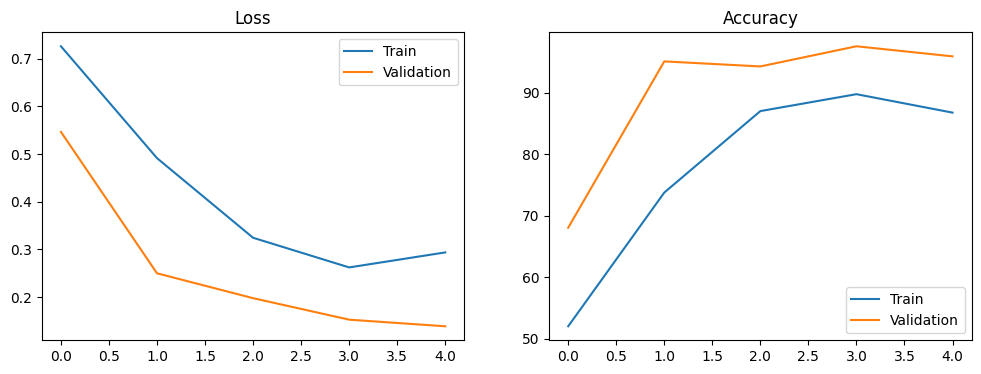

In [11]:
plot_history(history)

In [12]:
test_model(model, val_loader)

Acurácia da rede na base de teste: 95.90%


In [13]:
def plot_and_predict(model, image, class_names, device=device):
    model.eval()
    image = image.to(device)
    outputs = model(image.unsqueeze(0))
    _, predicted = torch.max(outputs.data, 1)
    probs = F.softmax(outputs, dim=1)[0] * 100
    prob = probs[predicted].item()

    # image between 0 and 1
    image = torch.clamp(image * 0.225 + 0.45, 0, 1)
    title = f'Classe: {class_names[predicted]} ({prob:.2f}%)'
    plt.imshow(image.permute(1, 2, 0).cpu().numpy())
    plt.title(title)
    plt.axis('off')
    plt.show()

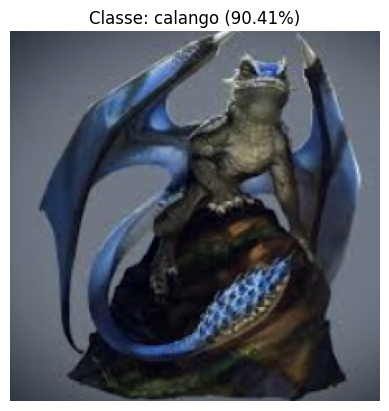

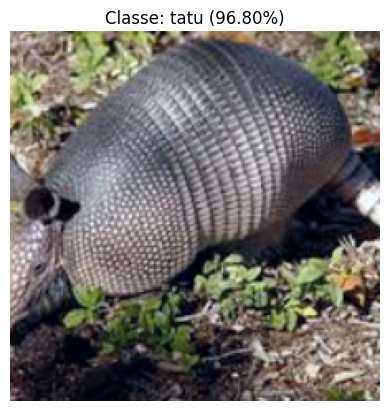

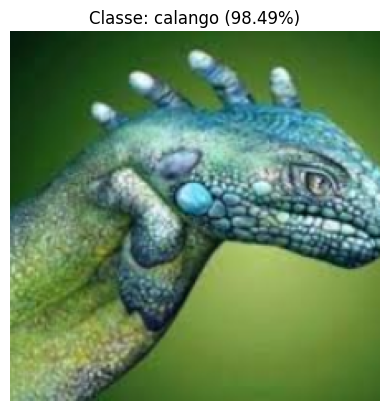

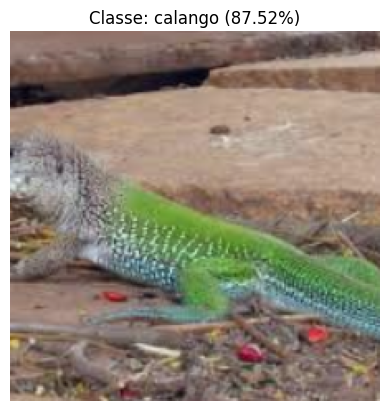

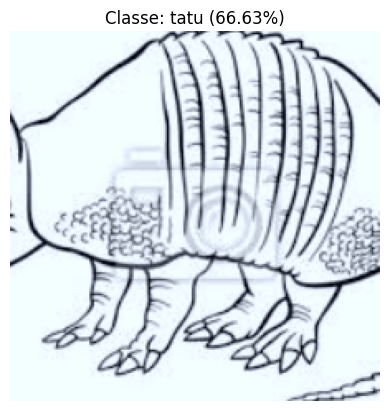

...

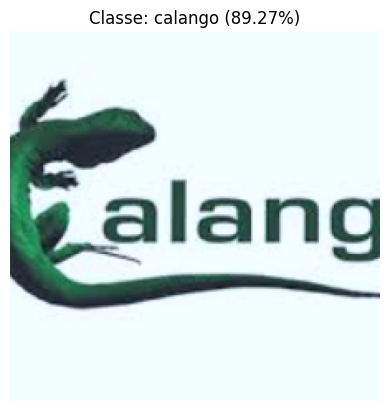

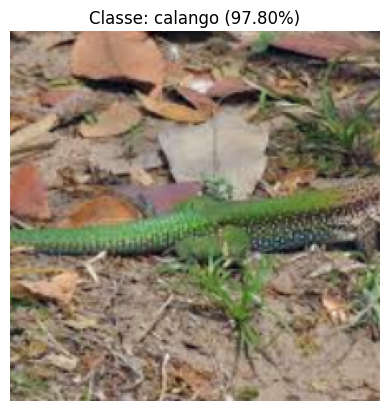

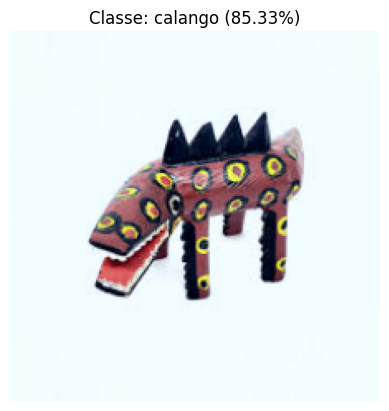

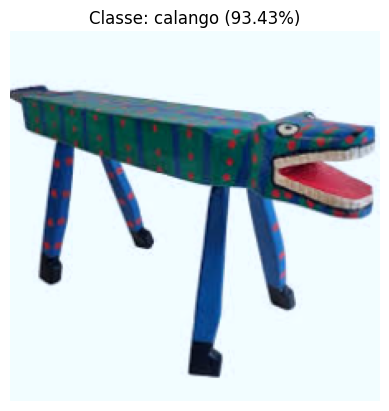

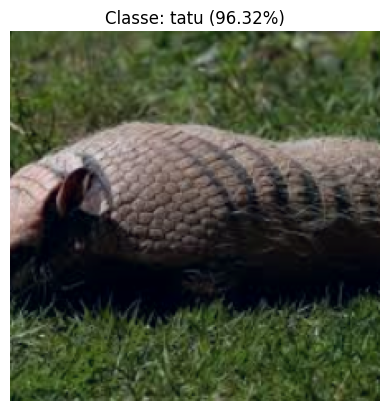

In [14]:
images, labels = next(iter(val_loader))

for image, label in zip(images, labels):
    plot_and_predict(model, image, val_set.classes)

## Exercícios

### Exercício 1
Treine novamente o modelo, mas sem data augmentation. Compare as curvas de treinamento de ambos os casos e comente.

100%|██████████| 13/13 [02:19<00:00, 10.75s/it]


Epoch 1, Train Loss: 0.696, Train Accuracy: 53.00%
Epoch 1, Val Loss: 0.480, Val Accuracy: 81.97%


100%|██████████| 13/13 [02:46<00:00, 12.83s/it]


Epoch 2, Train Loss: 0.368, Train Accuracy: 89.00%
Epoch 2, Val Loss: 0.293, Val Accuracy: 89.34%


100%|██████████| 13/13 [02:03<00:00,  9.46s/it]


Epoch 3, Train Loss: 0.248, Train Accuracy: 91.00%
Epoch 3, Val Loss: 0.196, Val Accuracy: 92.62%


100%|██████████| 13/13 [01:31<00:00,  7.07s/it]


Epoch 4, Train Loss: 0.205, Train Accuracy: 93.50%
Epoch 4, Val Loss: 0.185, Val Accuracy: 95.90%


100%|██████████| 13/13 [01:32<00:00,  7.09s/it]


Epoch 5, Train Loss: 0.182, Train Accuracy: 95.50%
Epoch 5, Val Loss: 0.146, Val Accuracy: 96.72%
Treinamento concluído


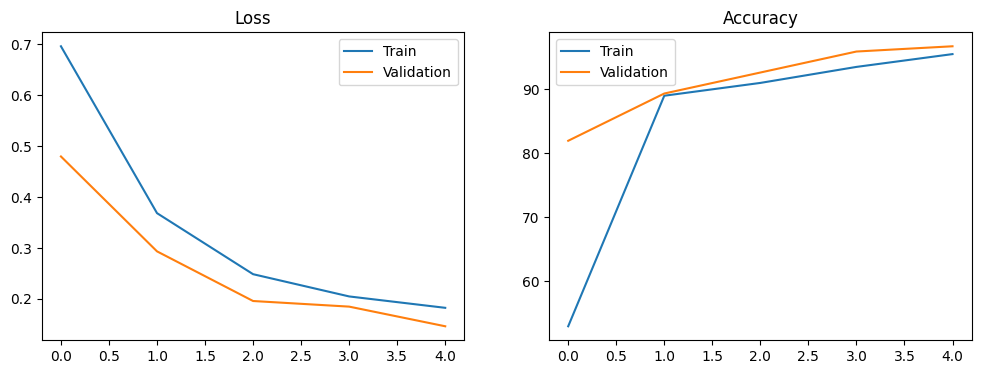

Acurácia da rede na base de teste: 96.72%


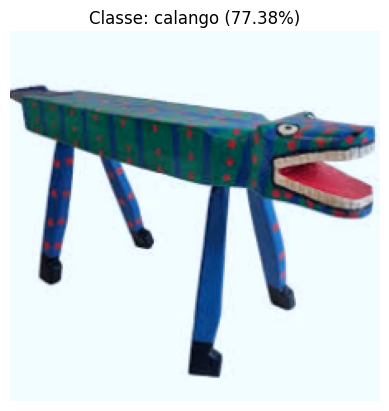

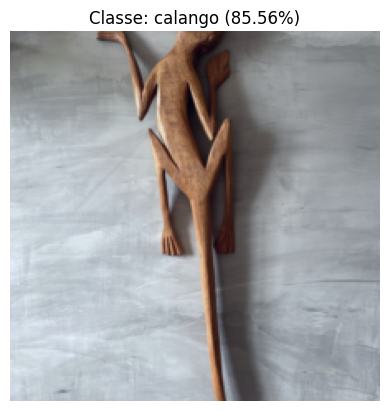

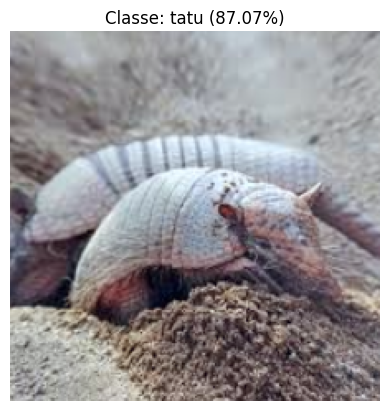

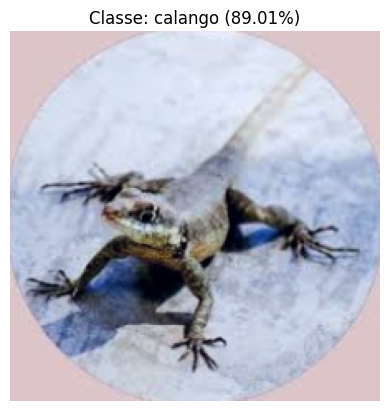

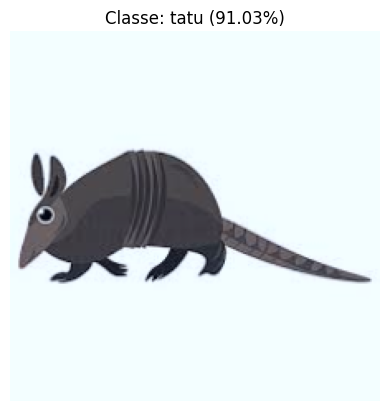

...

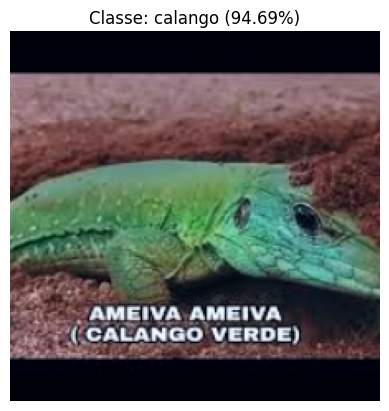

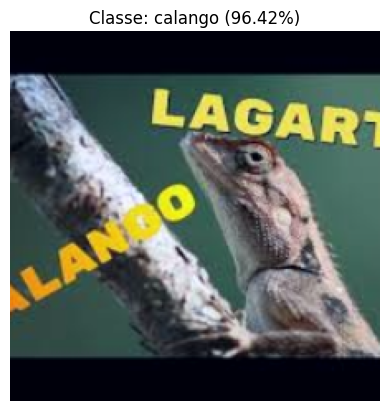

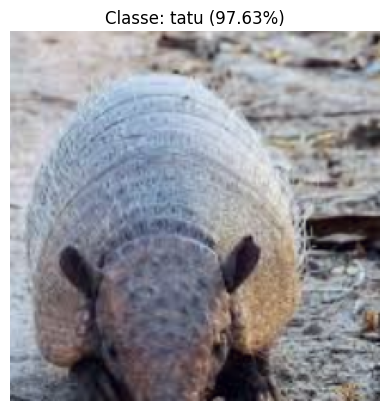

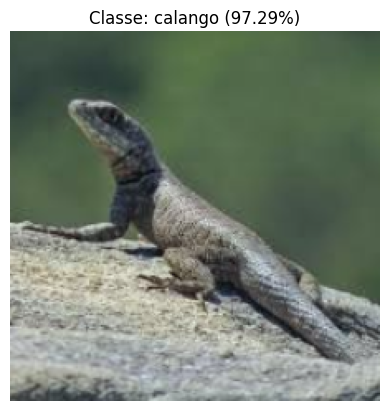

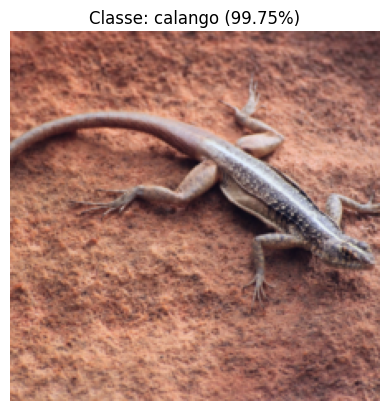

In [15]:
# Carregando os datasets
transform_aug = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

transform_no_aug = transforms.Compose([
    transforms.Resize(230),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# data_dir = 'data/hymenoptera_data'
data_dir = "data/animais"

train_set = datasets.ImageFolder(os.path.join(data_dir, 'train'), transform=transform_no_aug)
val_set = datasets.ImageFolder(os.path.join(data_dir, 'val'), transform=transform_no_aug)

train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32, shuffle=True)

model = models.resnet18(weights="IMAGENET1K_V1")

# Congelar todas as camadas
for param in model.parameters():
    param.requires_grad = False

# Substituir a última camada
model.fc = nn.Linear(model.fc.in_features, 2)
model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Treinando a CNN
history = train_model(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5)

plot_history(history)

test_model(model, val_loader)

images, labels = next(iter(val_loader))

for image, label in zip(images, labels):
    plot_and_predict(model, image, val_set.classes)

Resposta: Sem data augmentation percebe-se que a acurácia começou menor e foi aumentando com o passar das épocas, mas no final a acurácia ainda ficou menor do que usando o data augmentation.

### Exercício 2
Descongele mais das últimas camadas (à sua escolha), por exemplo `model.layer4[1]`, e treine novamente o modelo.

layer4.1.conv1.weight
layer4.1.bn1.weight
layer4.1.bn1.bias
layer4.1.conv2.weight
layer4.1.bn2.weight
layer4.1.bn2.bias
fc.weight
fc.bias


100%|██████████| 13/13 [01:35<00:00,  7.38s/it]


Epoch 1, Train Loss: 0.159, Train Accuracy: 95.00%
Epoch 1, Val Loss: 0.139, Val Accuracy: 96.72%


100%|██████████| 13/13 [02:07<00:00,  9.83s/it]


Epoch 2, Train Loss: 0.135, Train Accuracy: 96.00%
Epoch 2, Val Loss: 0.129, Val Accuracy: 96.72%


100%|██████████| 13/13 [01:54<00:00,  8.83s/it]


Epoch 3, Train Loss: 0.114, Train Accuracy: 98.00%
Epoch 3, Val Loss: 0.122, Val Accuracy: 96.72%


100%|██████████| 13/13 [01:48<00:00,  8.35s/it]


Epoch 4, Train Loss: 0.107, Train Accuracy: 97.50%
Epoch 4, Val Loss: 0.111, Val Accuracy: 95.90%


100%|██████████| 13/13 [02:21<00:00, 10.85s/it]


Epoch 5, Train Loss: 0.104, Train Accuracy: 96.75%
Epoch 5, Val Loss: 0.110, Val Accuracy: 97.54%
Treinamento concluído


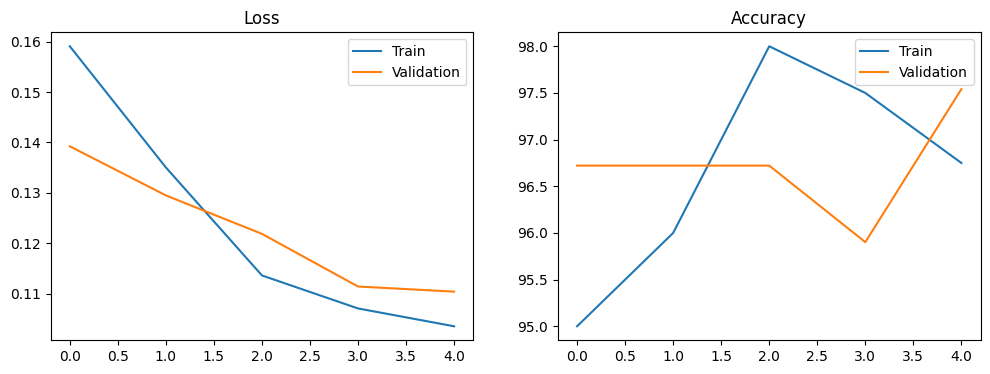

Acurácia da rede na base de teste: 97.54%


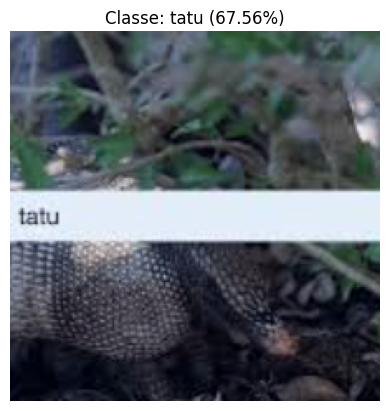

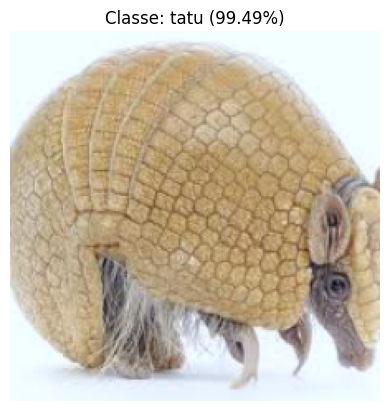

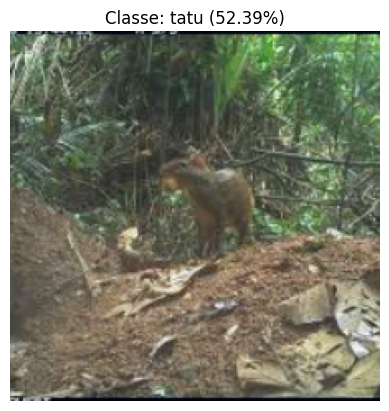

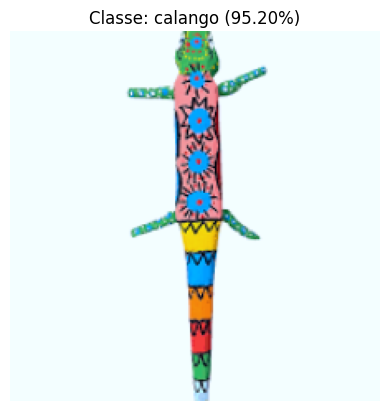

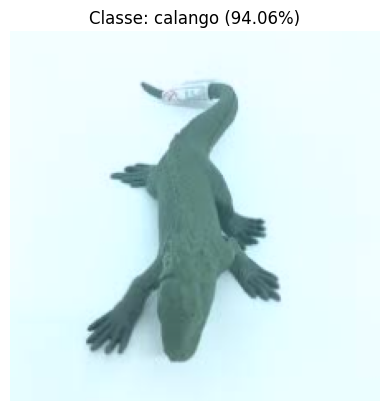

...

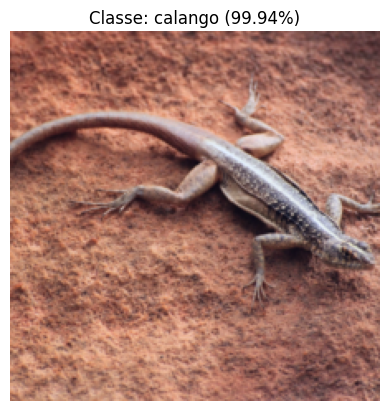

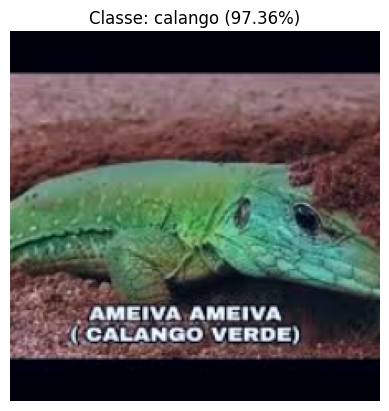

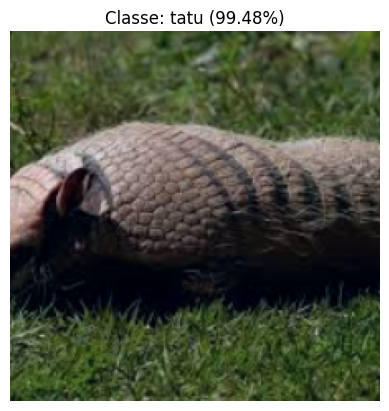

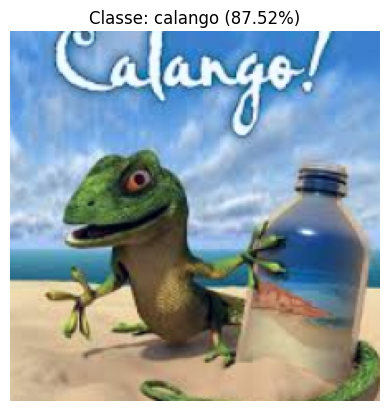

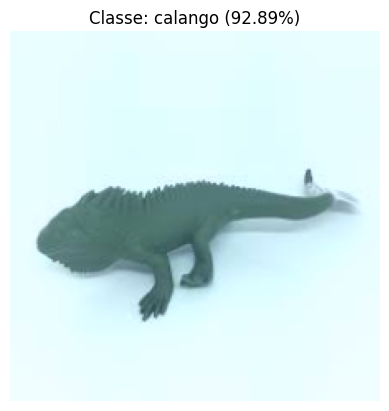

In [16]:
# Descongelar a camada model.layer4[1]
for param in model.layer4[1].parameters():
    param.requires_grad = True

# Verificar se as camadas foram descongeladas corretamente
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name)

# Treinar novamente o modelo
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(filter(lambda p: p.requires_grad, model.parameters()), lr=0.001, momentum=0.9)

# Treinando a CNN novamente
history = train_model(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5)

plot_history(history)

test_model(model, val_loader)

images, labels = next(iter(val_loader))

for image, label in zip(images, labels):
    plot_and_predict(model, image, val_set.classes)

### Exercício 3
Escolha outro modelo pré-treinado dos que foram vistos na aula e substitua no modelo. Lembre-se de alterar a última camada de classificação.

100%|██████████| 13/13 [38:24<00:00, 177.25s/it]


Epoch 1, Train Loss: 0.691, Train Accuracy: 50.00%
Epoch 1, Val Loss: 0.641, Val Accuracy: 75.41%


100%|██████████| 13/13 [15:23<00:00, 71.08s/it]


Epoch 2, Train Loss: 0.611, Train Accuracy: 78.25%
Epoch 2, Val Loss: 0.547, Val Accuracy: 85.25%


100%|██████████| 13/13 [13:43<00:00, 63.33s/it]


Epoch 3, Train Loss: 0.530, Train Accuracy: 86.00%
Epoch 3, Val Loss: 0.450, Val Accuracy: 92.62%


100%|██████████| 13/13 [15:38<00:00, 72.20s/it]


Epoch 4, Train Loss: 0.463, Train Accuracy: 90.25%
Epoch 4, Val Loss: 0.372, Val Accuracy: 95.08%


100%|██████████| 13/13 [14:46<00:00, 68.19s/it]


Epoch 5, Train Loss: 0.401, Train Accuracy: 89.50%
Epoch 5, Val Loss: 0.310, Val Accuracy: 95.90%
Treinamento concluído


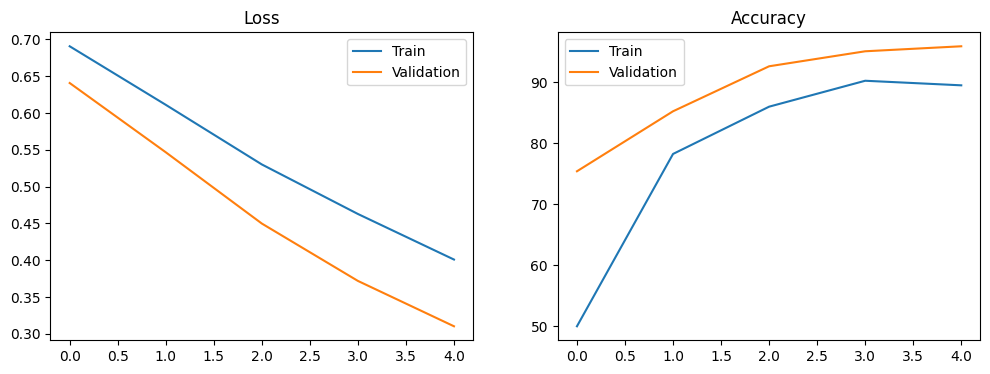

Acurácia da rede na base de teste: 95.90%


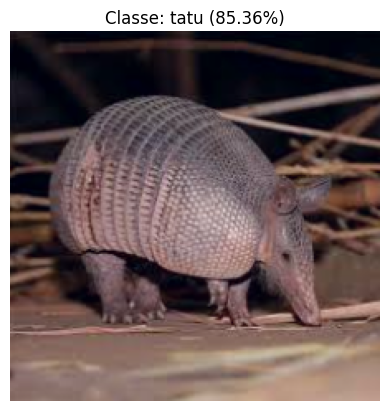

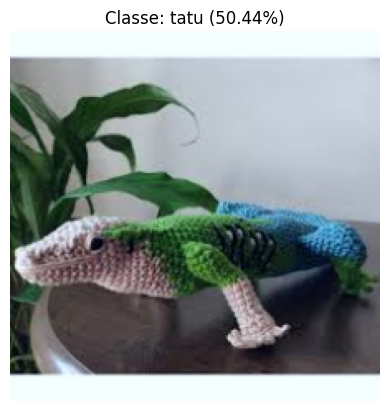

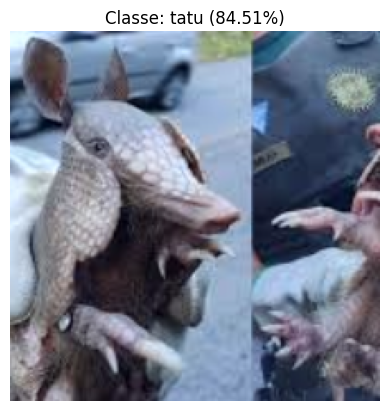

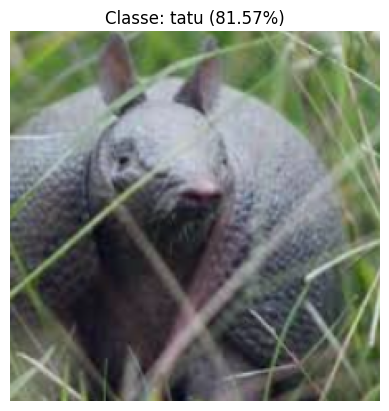

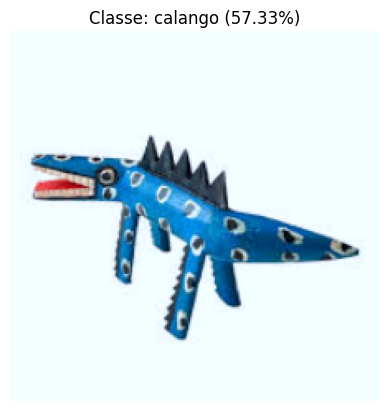

...

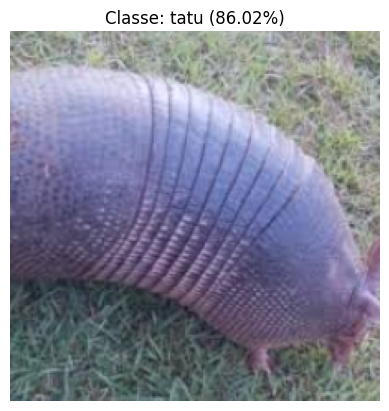

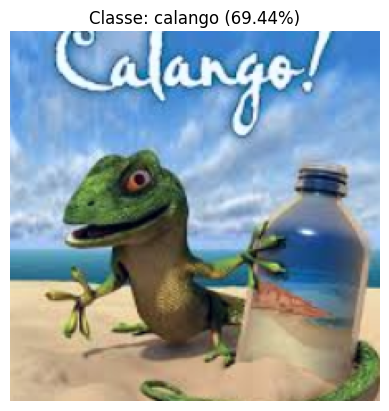

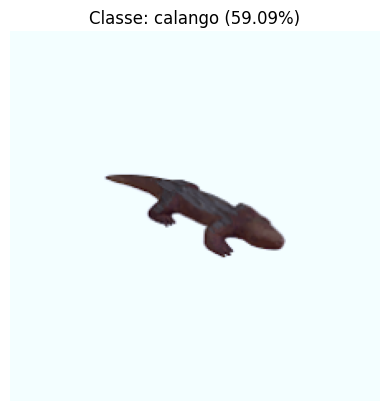

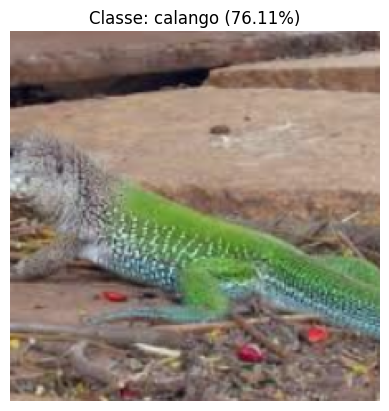

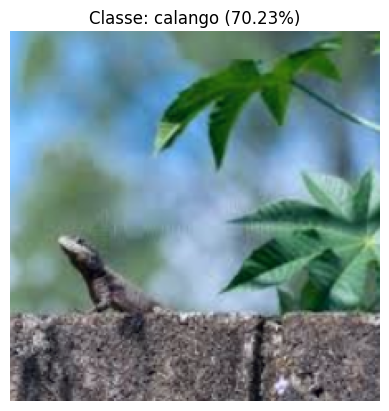

In [17]:
# Carregando os datasets
transform_aug = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

transform_no_aug = transforms.Compose([
    transforms.Resize(230),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# data_dir = 'data/hymenoptera_data'
data_dir = "data/animais"

train_set = datasets.ImageFolder(os.path.join(data_dir, 'train'), transform=transform_aug)
val_set = datasets.ImageFolder(os.path.join(data_dir, 'val'), transform=transform_no_aug)

train_loader = DataLoader(train_set, batch_size=32, shuffle=True)
val_loader = DataLoader(val_set, batch_size=32, shuffle=True)

weights = models.ResNet50_Weights.IMAGENET1K_V2
model = models.resnet50(weights=weights)

# Congelar todas as camadas
for param in model.parameters():
    param.requires_grad = True

# Substituir a última camada
model.fc = nn.Linear(model.fc.in_features, 2)
model = model.to(device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

# Treinando a CNN
history = train_model(model, train_loader, val_loader, criterion, optimizer, device, num_epochs=5)

plot_history(history)

test_model(model, val_loader)

images, labels = next(iter(val_loader))

for image, label in zip(images, labels):
    plot_and_predict(model, image, val_set.classes)